# Cell Type Annotation

In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import requests
import seaborn as sns
import pickle as pkl
from functools import reduce

/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
print(sc.__version__)
sc.settings.n_jobs=16

1.4.5.post1


In [3]:
prefix = '/data/codec/production.run/'

In [4]:
sc.settings.figdir = prefix + 'figs/'

### Load in Data

In [5]:
path = prefix + 'mrna/pkls/aggr/wells.sng.w_covars.pkl'

# with open(path,'wb') as file:
#     pkl.dump(wells, file)
    
with open(path,'rb') as file:
    wells = pkl.load(file)

### Adjust Cell Barcodes, Filter

I'm adjusting the cell barcodes to make them match their well number, which I also did with the ADTs.

In [6]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

### Concatenate

In [7]:
concat = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])

In [8]:
path = prefix + 'adts/pkls/concat.adts.pkl'

# with open(path,'wb') as file:
#     pkl.dump(wells, file)
    
with open(path,'rb') as file:
    raw_adts = pkl.load(file)

In [9]:
raw_adts.obs = raw_adts.obs.join(concat.obs[['cond','free_id', 'percent_mito', 'viability_eq_ctrl', 'viability_sample']])

In [10]:
adts = raw_adts.copy()

In [11]:
path = prefix + 'mrna/obs/label.mito/mito.csv'
obs = pd.read_csv(path, index_col=0)
obs = obs[(obs['ct1'] == 'LOW_MITO') & (obs['ct2'] == 'NORMAL')].index.values

In [12]:
adts = adts[obs].copy()
adts.var['subsetted_adts_n_counts'] = adts.X.toarray().sum(axis=0)

In [13]:
adts.shape

(136142, 96)

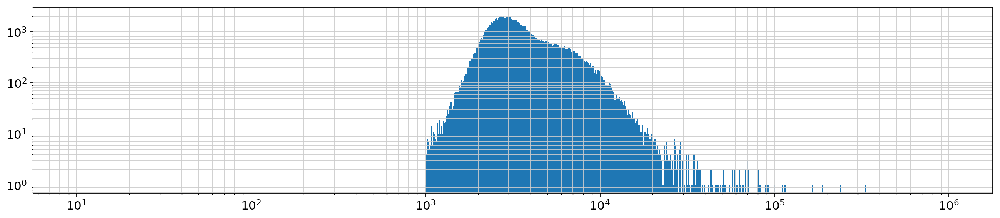

In [14]:
plt.figure(figsize=(20,4))
plt.hist(adts.obs['adts_n_counts'].values, bins=np.logspace(np.log10(10),np.log10(1e6), 1000))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
plt.yscale('log')

In [15]:
def clr_normalize_column(x):
    normed_column = np.log1p((x) / (np.exp(sum(np.log1p((x)[x > 0 ])) / len(x + 1))))
    return normed_column
def clr_normalize(x):
    normed_matrix = np.apply_along_axis(clr_normalize_column, 1, x)
    return normed_matrix

In [16]:
sc.pp.normalize_per_cell(adts, counts_per_cell_after=1e6);

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [17]:
adts.X = clr_normalize(adts.X.toarray())

In [18]:
sc.pp.scale(adts)

In [19]:
sc.pp.combat(adts, key='batch',covariates=['free_id'])
sc.pp.scale(adts)
sc.pp.combat(adts, key='cond',covariates=['free_id'])
sc.pp.scale(adts)

... storing 'cond' as categorical
... storing 'free_id' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 1 categorical variables:
	free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

Standardizing Data across genes.

Found 7 batches

Found 1 categorical variables:
	free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



In [20]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(adts, n_neighbors=15, n_pcs=0) # use .X because all the surface markers we're looking at are probably pretty important
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    computed neighbors (0:01:28)
    computed connectivities (0:00:05)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:34)


In [21]:
sc.tl.umap(adts)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:58)


In [ ]:
sc.tl.leiden(adts, resolution=1)

After running this, I decided to break up the B cells into two clusters because labeling them on the mRNA UMAP will be hard.

In [12]:
sc.tl.leiden(adts, resolution=0.2, restrict_to=('leiden', ['4']))
stupid_name_clusts = adts.obs['leiden'].dtype.categories
for i, j in zip(stupid_name_clusts, range(len(stupid_name_clusts))):
    adts.obs['leiden'].replace(i, j, inplace=True)
adts.obs['leiden'] = adts.obs['leiden'].astype(int)
adts.obs['leiden'] = adts.obs['leiden'].astype(str)

running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


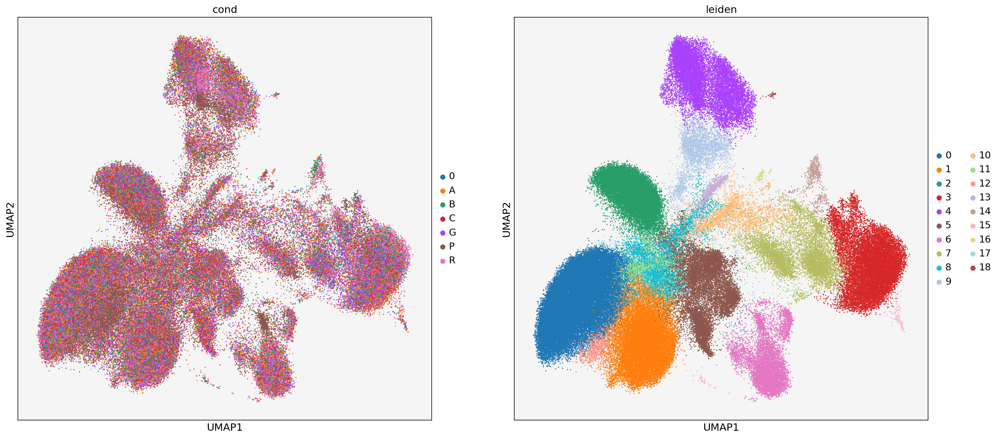

In [7]:
fig, ax = plt.subplots(1, 2, figsize=(22,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    ax.set_facecolor('whitesmoke')
    sc.pl.umap(adts, color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

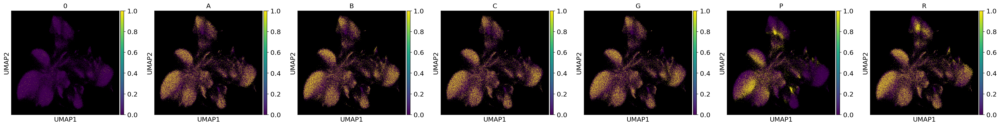

In [24]:
fig, ax = plt.subplots(1,7, figsize=(30,4))
for val, ax in tqdm(zip(adts.obs['cond'].dtype.categories, np.ravel(ax))):
    adts.obs['val'] = adts.obs['cond'] == val
    ax.set_facecolor('black')
    sc.pl.umap(adts,color='val', ax=ax, show=False, return_fig=False, title=val)
    adts.obs.drop(columns='val', inplace=True)
plt.tight_layout()

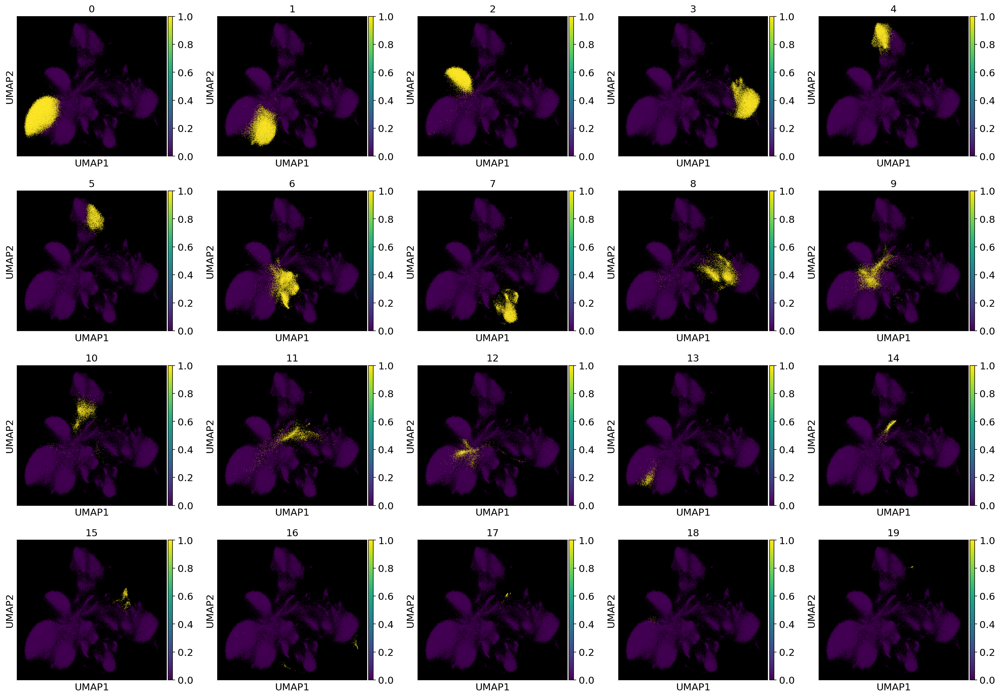

In [14]:
fig, ax = plt.subplots(4,5,figsize=(20,14))
for val, ax in tqdm(zip(adts.obs['leiden'].dtype.categories, np.ravel(ax))):
    adts.obs['val'] = adts.obs['leiden'] == val
    ax.set_facecolor('black')
    sc.pl.umap(adts,color='val', ax=ax, show=False, return_fig=False, title=val)
    adts.obs.drop(columns='val', inplace=True)
plt.tight_layout()

In [5]:
path = prefix + 'adts/h5ads/adts.1.h5ad'

# adts.write_h5ad(path)
adts = sc.read_h5ad(path)

### Proteins

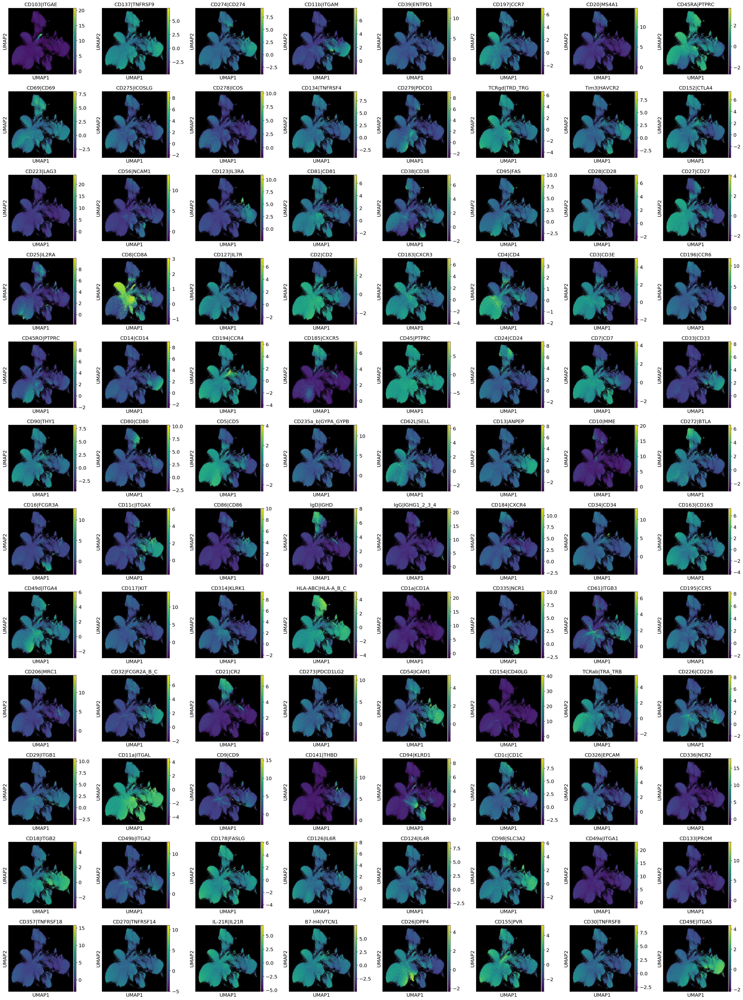

In [35]:
fig, ax = plt.subplots(12,8,figsize=(30,40))
for p, ax in tqdm(zip(adts.var_names, np.ravel(ax))):
    ax.set_facecolor('black')
    sc.pl.umap(adts, color=p, size=3, ncols=8, ax=ax, show=False, return_fig=False, use_raw=False)
plt.tight_layout()

In [15]:
conds = adts.obs['cond'].dtype.categories
clusts = adts.obs['leiden'].dtype.categories

In [16]:
cond_leiden_df = pd.DataFrame(index=conds, columns=clusts, dtype=np.int)

In [17]:
for cond in tqdm(conds):
    for clust in clusts:
        cond_leiden_df.loc[cond, clust] = adts[(adts.obs['cond'] == cond) & (adts.obs['leiden'] == clust)].shape[0]

In [18]:
cond_leiden_df_div = cond_leiden_df.divide(cond_leiden_df.sum(0),1)

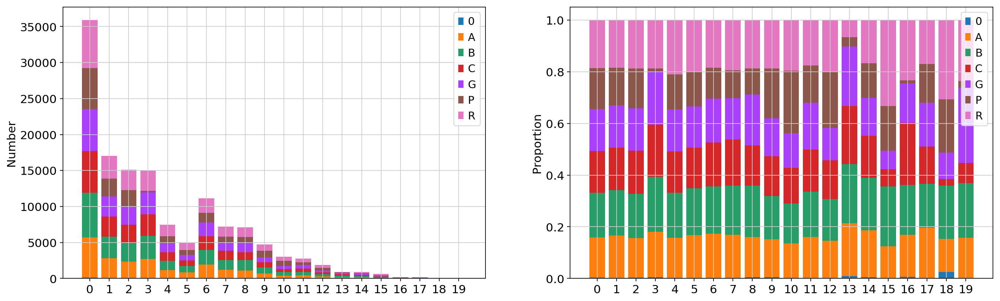

In [19]:
fig, ax = plt.subplots(1,2,figsize=(20,6))
for ax, df, ylabel in zip(ax, [cond_leiden_df, cond_leiden_df_div], ['Number','Proportion']):
    labels = clusts
    props = dict()

    for cond in conds:
        props[cond] = df.loc[cond].values
    lastpos = [0]*len(clusts)
    for cond in props:
        ax.bar(labels, props[cond], label=cond, bottom=lastpos)
        lastpos = props[cond] + lastpos

    ax.set_ylabel(ylabel)
    ax.legend()

# Differential Expression

In [24]:
def get_raw_adts(obs_names):
    path = prefix + 'adts/pkls/concat.adts.pkl'
    
    with open(path,'rb') as file:
        return pkl.load(file)[obs_names, :]

def get_raw_mrna(obs_names):
    path = prefix + 'mrna/pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    return wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[obs_names,:]
    
def clr_normalize_column(x):
    normed_column = np.log1p((x) / (np.exp(sum(np.log1p((x)[x > 0 ])) / len(x + 1))))
    return normed_column

def clr_normalize(x):
    normed_matrix = np.apply_along_axis(clr_normalize_column, 1, x)
    return normed_matrix
    
def add_raw(adata, transformed=True):
    raw_mrna = get_raw_mrna(adata.obs_names)
    raw_adts = get_raw_adts(adata.obs_names)
    
    adata.obs['adts_n_counts'] = raw_adts.X.toarray().sum(axis=1)
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw_mrna,counts_per_cell_after=1e6)
        sc.pp.log1p(raw_mrna)
        
        sc.pp.normalize_per_cell(raw_adts, counts_per_cell_after=1e6);
        raw_adts.X = clr_normalize(raw_adts.X.toarray())
    
    raw = raw_mrna.T.concatenate(raw_adts.T).T
    raw.var_names = [i[:-2] for i in raw.var_names]
    adata.raw = raw
    
    return

In [25]:
add_raw(adts)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:04): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [87]:
def grouped_rank(adata, groups, return_genes=True, size=5, n_genes=20, figsize=(5,5)):

    assert len(groups) == 2
    for i in range(2):
        groups[i] = np.array(groups[i]).astype(str)
        
    grouped_clusts = [i for j in groups for i in j]
    numclusts = np.unique(adata.obs['leiden'].values)
    groups.append(np.setdiff1d(numclusts, grouped_clusts).astype('<U21'))
    fig, axes = plt.subplots(1, 2, figsize=(9, 4))
    for clusts, title, ax in zip(groups, ['0','1'], axes):
        adata.obs['val'] = adata.obs['leiden'].isin(clusts).values
        ax.set_facecolor('black')
        sc.pl.umap(adata,color='val', ax=ax, size=size, show=False, return_fig=False, title=title)
    adata.obs.drop(columns='val', inplace=True)

    adata.obs['rank_compare'] = adata.obs['leiden'].copy()
    groups_dict = dict(zip(range(3), groups))
    for group in groups_dict:
        for clust in groups_dict[group]:
            adata.obs['rank_compare'].replace(clust, 'ct%s' % group, regex=True, inplace=True)
    adata.obs['rank_compare'] = adata.obs['rank_compare'].str.replace('ct','').astype('category')
    
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    sc.settings.verbosity = 0
    for ax in np.ravel(ax):
        rank_adata = adata.copy()
        sc.tl.rank_genes_groups(rank_adata, groupby='rank_compare', n_genes=n_genes, groups=['0'], reference='1', use_raw=True)
        y = range(n_genes)[::-1]
        x = [i[0] for i in rank_adata.uns['rank_genes_groups']['scores'].tolist()][:n_genes]
        genes = [i[0] for i in rank_adata.uns['rank_genes_groups']['names'].tolist()]
        txts = genes[:n_genes]
        ax.scatter(x, y, s=0)
        for i, txt in enumerate(txts):
            ax.annotate(txt, (x[i], y[i]), rotation=0, size=10)
        ax.set_yticklabels([])
        ax.set_title('0 vs 1')
    sc.settings.verbosity = 4
    adata.obs.drop(columns='rank_compare', inplace=True)
    if return_genes == True:
        return genes
    else:
        return 

In [145]:
g1 = [10]
# g2 = [1]
g2 = [i for i in range(31) if i not in g1]

g1 = [str(i) for i in g1]
g2 = [str(i) for i in g2]

In [ ]:
genes = grouped_rank(adts_no_low, groups=[g1, g2], size=5, n_genes=20, figsize=(5,5))

In [89]:
def low_de_make(adata, p=0.2, p_of='any'):
    '''
    adata = adata object with a raw attribute
    p = percentage of cells that should be expressing a gene for it to be reported
    p_of = when subsetting genes to report, at least p percent of cells in ANY cluster ('any') \n
    should be expressing the gene, or only in the provided cluster
    '''
    X = adata.raw.X.copy()
    clusts = adata.obs['leiden'].dtype.categories
    df = pd.DataFrame(0,index=clusts, columns=adata.raw.var_names.values,dtype=np.float16)
    for clust in clusts:
        clustbool = (adata.obs['leiden'] == clust).values
        clustX = X[clustbool]
        clustX = clustX.tocsc()
        df.loc[clust] = clustX.getnnz(axis=0)/clustX.shape[0]
    if p_of == 'any':
        df = df.iloc[:,df.apply(lambda x: np.any(x > p), axis=0, raw=True).values]
    else:
        df = df.iloc[:,(df.loc[p_of] > p).values]
    return df

def low_de_compare(df, clust, compare=None):
    if type(compare) == type(None): 
        return (df.loc[clust]/df[~(df.index == clust)].mean()).sort_values(ascending=False)
    elif type(compare) == list:
        return (df.loc[clust]/df[(df.index.isin(compare))].mean()).sort_values(ascending=False)

In [149]:
df = low_de_make(adts, p=0.01, p_of=g1[0])

In [150]:
de_genes = low_de_compare(df, g1[0], compare=g2)

In [151]:
print(de_genes[:10])

GCK           2.095703
TRAV13-1      1.941406
SULT1B1       1.935547
FAM153A       1.915039
CIDEB         1.882812
C22orf42      1.790039
AC004988.1    1.772461
MTRNR2L8      1.750977
TNNT1         1.743164
MALINC1       1.730469
dtype: float16


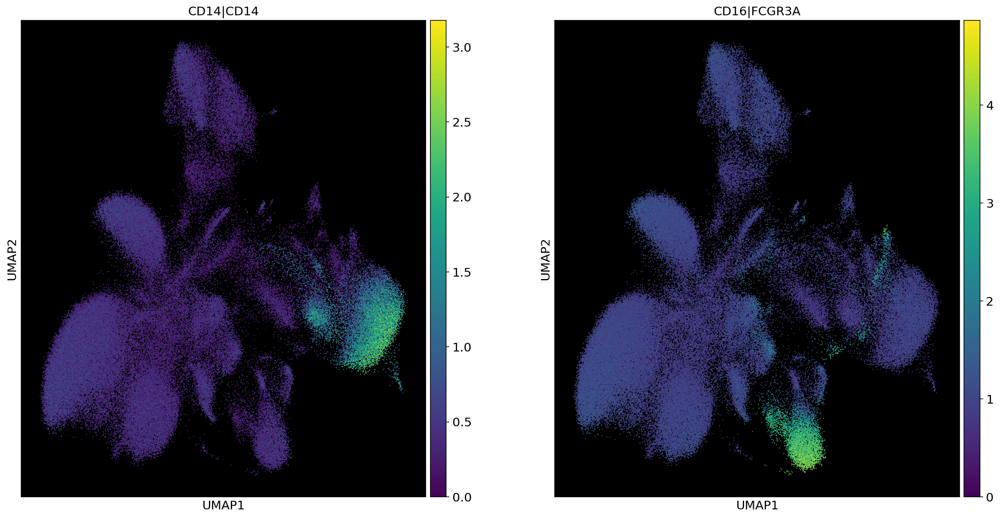

In [153]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['CD14|CD14', 'CD16|FCGR3A'], ax):
    ax.set_facecolor('black')
    sc.pl.umap(adts, color=color, ax=ax, show=False, return_fig=False, size=5)

In [12]:
features = ['CD45RO|PTPRC', 'CD45RA|PTPRC', 'CD3|CD3E', 'CD4|CD4','CD8|CD8A'] 
#             'IL7R', 'CD38|CD38', 'CD38', 'SELL', 'CD62L|SELL', 
#             'CCR7', 'CD197|CCR7', 'CD69', 'CD69|CD69', 'CD27', 'CD27|CD27']

In [22]:
focus_clusts = ['0', '13', '1']

In [23]:
colors = dict(zip(adts.obs['leiden'].dtype.categories, adts.uns['leiden_colors']))

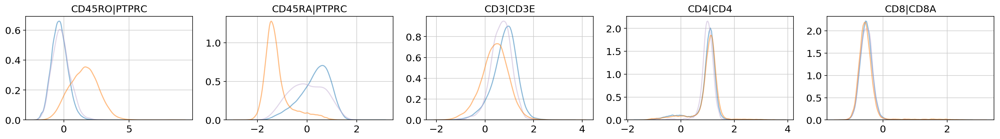

In [24]:
fig, ax = plt.subplots(1, 5, figsize=(20,3))
for f, ax in zip(features, np.ravel(ax)):
    for clust, color in zip(focus_clusts, map(lambda x: colors[x], focus_clusts)):
        sns.kdeplot(np.array(adts[adts.obs['leiden'] == clust].obs_vector(f)), # need the np.array wrapper because for the genes it returns an "Array View"
                color=color, alpha=0.5, ax=ax)
    ax.set_title(f)
plt.tight_layout()

# Add Labels

In [9]:
cts = pd.read_csv(prefix + 'adts/cts/cts.1.tsv', sep='\t', dtype='|S').set_index('cluster')

In [10]:
s = pd.Series(adts.obs['leiden'].values)

In [11]:
for ct in cts.columns:
    adts.obs[ct] = s.map(dict(cts[ct])).values

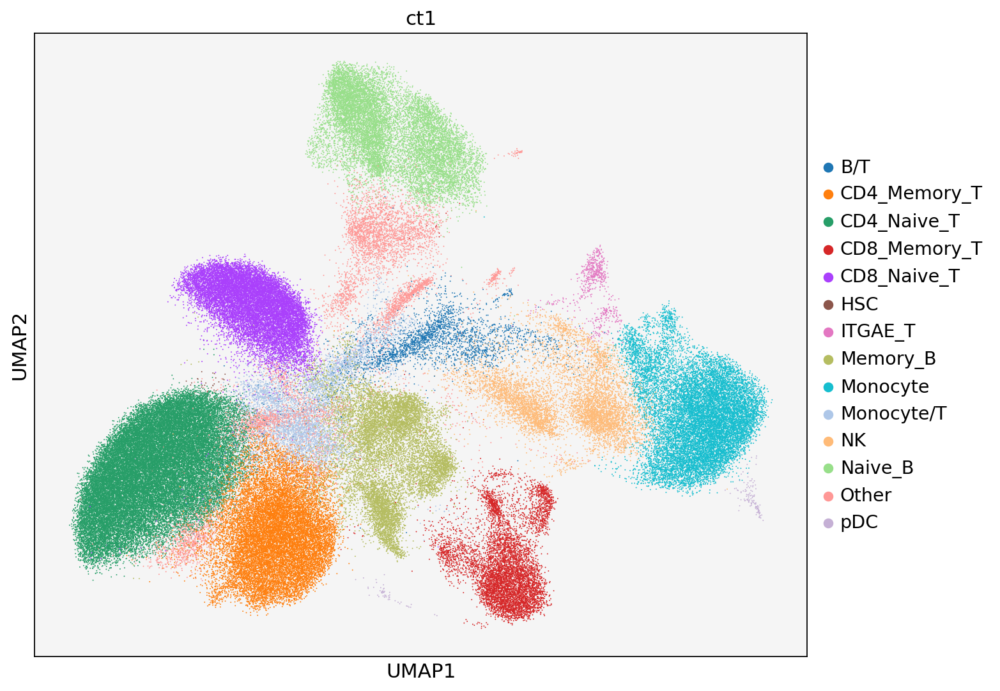

In [16]:
fig, ax = plt.subplots(1,1,figsize=(10,7))
for ax, f in zip(np.ravel(ax), ['ct1']):
    ax.set_facecolor('whitesmoke')
    sc.pl.umap(adts, color=f, ax=ax,show=False, return_fig=False, size=3)
plt.tight_layout()

In [39]:
path = prefix + 'adts/obs/cts.1.obs.csv'
adts.obs[['ct1']].to_csv(path)

In [40]:
path = prefix + 'adts/h5ads/adts.2.h5ad'

# adts.write_h5ad(path)
adts = sc.read_h5ad(path)

# Figures

In [30]:
filename = 'adts.all.cond.umap.pdf'
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for color, ax in zip(['cond'], [ax]):
    sc.pl.umap(adts, color=color, ax=ax, show=False, return_fig=False, size=2, save='/' + filename)

In [57]:
filename = 'adts.nolow.cond.umap.pdf'
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for color, ax in zip(['cond'], [ax]):
    sc.pl.umap(adts_no_low, color=color, ax=ax, show=False, return_fig=False, size=2, save='/' + filename)

In [58]:
filename = 'adts.nolow.leiden.umap.pdf'
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for color, ax in zip(['leiden'], [ax]):
    sc.pl.umap(adts_no_low, color=color, ax=ax, show=False, return_fig=False, size=2, save='/' + filename)

In [ ]:
filename = str(sc.settings.figdir) + '/multi.umap/adts.proteins.pdf'
fig, ax = plt.subplots(12,8,figsize=(30,40))
for p, ax in tqdm(zip(adts_no_low.var_names, np.ravel(ax))):
    axadts_no_lowcecolor('black')
    sc.pl.umap(adts_no_low, color=p, size=3, ncols=8, ax=ax, show=False, return_fig=False, use_raw=False)
plt.tight_layout()
plt.savefig(filename, dpi=80)
plt.close()

In [72]:
for i in ['ct1', 'ct2', 'ct3']:
    filename = 'adts.%s.umap.pdf' % i
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    for color, ax in zip([i], [ax]):
        sc.pl.umap(adts_no_low, color=color, ax=ax, show=False, return_fig=False, size=2, save='/' + filename)